<a href="https://colab.research.google.com/github/juandiego2205/Biosenales/blob/main/Proyecto3/P3_JuanCaguasango_KevinGarcia.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [39]:
pip install pyWavelets

Importación de las bibliotecas necesarias para el proyecto número 3 y verificación del flujo de filtrado.

In [40]:
import pywt
from IPython.display import HTML
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import zipfile
import seaborn as sns
from scipy import stats
import scipy.signal as signal
from scipy.signal import detrend , welch
from scipy.stats import mannwhitneyu
from google.colab import drive
from scipy.fftpack import fft as ft;
import scipy.io as sio;
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#**Funciones del Proyecto**

Función para almacenar en listas los datos de los archivos en formato zip de los proyectos 2 y 3.

In [41]:
def procesar_ecg(lista_pacientes, df_filtrado, lista_registro, lista_estados, lista_valores_ecg, archivo_zip,t):
    nueva_lista = [f"{elemento}.csv" for elemento in lista_pacientes]  # Generar lista de nombres de archivo

    with zipfile.ZipFile(archivo_zip, 'r') as zip_ref:
        # Iterar sobre cada archivo en el ZIP
        for archivo in zip_ref.namelist():
            # Verificar si el nombre del archivo está en la lista
            if t==0:
                clean_filename = archivo.replace("ECGData/", "")
            else:
                clean_filename = archivo.replace("ECGDataDenoised/", "")
            if clean_filename in nueva_lista:
                # Extraer el archivo
                zip_ref.extract(archivo)
                # Filtrar el DataFrame
                df_filtrado2 = df_filtrado[df_filtrado['FileName'] == clean_filename]
                estado = df_filtrado2['Rhythm'].values
                lista_estados.append(estado)
                lista_registro.append(clean_filename)

                # Leer datos del archivo extraído, saltando la primera fila
                data_sujetos = pd.read_csv(archivo, delimiter=',', names=['I', 'II', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6'], skiprows=1)

                # Convertir los valores de la columna 'II' a flotantes
                data_sujetos_n = data_sujetos['II'].astype(float).values
                lista_valores_ecg.append(data_sujetos_n)

Funciones para aplicar el umbral a los detalles de la transformada Haar en los filtros donde se utiliza el filtro no lineal Wavelet.

usa el factor 0.6745 para ajustar la mediana a la desviación estándar en una distribución normal. Este método es robusto contra valores atípicos, lo que lo hace adecuado para estimar el ruido en presencia de datos no gaussiano

 stdc, que contiene la estimación de la desviación estándar del ruido para cada nivel de los coeficientes.

In [42]:
def wnoisest(coeff):
    stdc = np.zeros((len(coeff),1));
    for i in range(0,len(coeff)):
        stdc[i] = (np.median(np.absolute(coeff[i])))/0.6745;
    return stdc;
def threshold(coeff):
    Num_samples = 0;
    for i in range(0,len(coeff)):
        Num_samples = Num_samples + coeff[i].shape[0];
    thr = np.sqrt(2*(np.log(Num_samples)))
    return thr
def wthresh(coeff):
    y   = list();
    s = wnoisest(coeff);
    thr = threshold(coeff)
    for i in range(0,len(coeff)):
        y.append(np.multiply(coeff[i],np.abs(coeff[i])>(thr*s[i])));
    return thr,s,y;


Función para la eliminación de valores atípicos en las señales.

In [43]:
def eliminar_outliers(data):
    # Calcular cuartiles y rango intercuartil
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    # Definir límites para detectar outliers
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    # Filtrar los datos para eliminar los outliers
    return data[(data >= lower_bound) & (data <= upper_bound)]

#**Señales del Proyecto 3**

Señales del proyecto 3 sin aplicar proceso de filtrado, extracción en formato zip.

In [44]:
!cp /content/drive/MyDrive/Proyecto_3/ECGData.zip .
!unzip ECGData.zip

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: ECGData/MUSE_20180116_125802_57000.csv  
  inflating: ECGData/MUSE_20180116_125812_73000.csv  
  inflating: ECGData/MUSE_20180116_125822_43000.csv  
  inflating: ECGData/MUSE_20180116_125825_58000.csv  
  inflating: ECGData/MUSE_20180116_125842_09000.csv  
  inflating: ECGData/MUSE_20180116_125845_27000.csv  
  inflating: ECGData/MUSE_20180116_125847_39000.csv  
  inflating: ECGData/MUSE_20180116_125906_02000.csv  
  inflating: ECGData/MUSE_20180116_125918_29000.csv  
  inflating: ECGData/MUSE_20180116_125919_34000.csv  
  inflating: ECGData/MUSE_20180116_125921_43000.csv  
  inflating: ECGData/MUSE_20180116_125925_64000.csv  
  inflating: ECGData/MUSE_20180116_125946_45000.csv  
  inflating: ECGData/MUSE_20180116_125948_54000.csv  
  inflating: ECGData/MUSE_20180116_130000_80000.csv  
  inflating: ECGData/MUSE_20180116_130002_89000.csv  
  inflating: ECGData/MUSE_20180116_130009_24000.csv  
  inflating: ECGData/

Extracción de las referencias del dataframe diagnostics para almacenar únicamente las referencias de los pacientes con patologías de Bradicardia Sinusal y Fibrilación Auricular.

In [45]:
# Dataframe con los registros de cada señal
DatosBase=pd.read_excel('/content/drive/MyDrive/Proyecto_3/Diagnostics.xlsx')
df_filtradoAfib=DatosBase[DatosBase['Rhythm'] == 'AFIB']
ListaPacientes1 = df_filtradoAfib['FileName'].tolist()
df_filtradoSB=DatosBase[DatosBase['Rhythm'] == 'SB']
ListaPacientes2 = df_filtradoSB['FileName'].tolist()
Fs = 500
muestras = np.arange(5000)
tiempo = muestras / Fs

Se hace el uso de la funciòn de almacenamiento de datos tanto SB como AFIB para las señales del proyecto 3.

---



In [38]:
# Inicializar listas P3
#AFIB
ListaRegistro1 = []
ListaEstados1 = []
ListaValoresECG1 = []
#SB
ListaRegistro2 = []
ListaEstados2 = []
ListaValoresECG2 = []
# Procesar los datos de los dos grupos
procesar_ecg(ListaPacientes1, df_filtradoAfib, ListaRegistro1, ListaEstados1, ListaValoresECG1, "/content/ECGData.zip",0)
procesar_ecg(ListaPacientes2, df_filtradoSB, ListaRegistro2, ListaEstados2, ListaValoresECG2, "/content/ECGData.zip",0)

#**Señales del Proyecto 2**

Señales del proyecto 2 con filtros previamente colocados en la base de datos, extracción en formato zip.

In [46]:
!cp /content/drive/MyDrive/Proyecto_3/ECGDataDenoised.zip .
!unzip ECGDataDenoised.zip

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: ECGDataDenoised/MUSE_20180116_125802_57000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125812_73000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125822_43000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125825_58000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125842_09000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125845_27000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125847_39000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125906_02000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125918_29000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125919_34000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125921_43000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125925_64000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125946_45000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_125948_54000.csv  
  inflating: ECGDataDenoised/MUSE_20180116_130000_80000.csv  
  inflati

Se hace el uso de la funciòn de almacenamiento de datos tanto SB como AFIB para las señales del proyecto 2.

In [47]:
# Inicializar listas
#AFIB filtrado P2
ListaRegistro1Fil = []
ListaEstados1Fil = []
ListaValoresECG1Fil = []
#SB filtrado P2
ListaRegistro2Fil = []
ListaEstados2Fil = []
ListaValoresECG2Fil = []
# Procesar los datos de los dos grupos
procesar_ecg(ListaPacientes1, df_filtradoAfib, ListaRegistro1Fil, ListaEstados1Fil, ListaValoresECG1Fil, "/content/ECGDataDenoised.zip",1)
procesar_ecg(ListaPacientes2, df_filtradoSB, ListaRegistro2Fil, ListaEstados2Fil, ListaValoresECG2Fil, "/content/ECGDataDenoised.zip",1)

In [48]:
# verificar la existencia de los datos
print(len(ListaValoresECG1Fil))
print(len(ListaValoresECG2Fil))
print(len(ListaValoresECG1))
print(len(ListaValoresECG2))

1780
3889
1780
3889


#**Selecciòn de Señales de Prueba**

Se seleccionaron señales de prueba de amabas conjuntos de datos, tanto del proyecto 3 como del proyecto 2

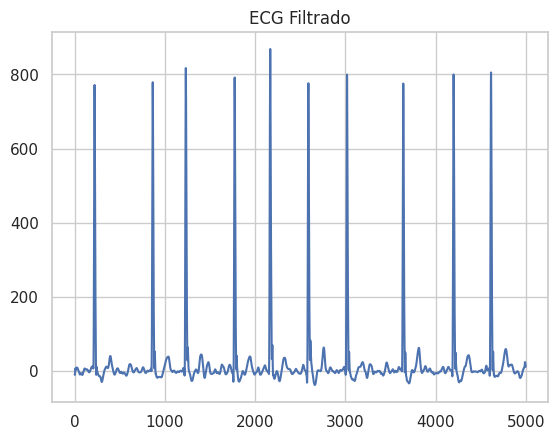

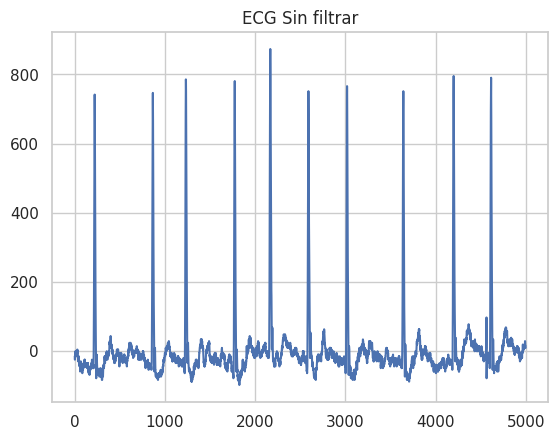

In [49]:
#Sub listas SB AFIB P3
afibPruebaFil=ListaValoresECG1Fil[0:10]
sbPruebaFil=ListaValoresECG2Fil[0:10]

EstadosFil=[afibPruebaFil,sbPruebaFil]
registros=[ListaRegistro1Fil,ListaRegistro2Fil]
afibPrueba=ListaValoresECG1[0:10]
sbPrueba=ListaValoresECG2[0:10]
Estados=[afibPrueba,sbPrueba]
registros=[ListaRegistro1,ListaRegistro2]
plt.plot(ListaValoresECG1Fil[340])
plt.title("ECG Filtrado")
plt.show()
plt.plot(ListaValoresECG1[340])
plt.title("ECG Sin filtrar")
plt.show()





#**Diagrama de Bode**

En el diagrama de Bode se observó la diferencia entre los filtros IIR y FIR para las dos frecuencias analizadas: pasaaltas y pasabajas, es decir, 0,5 Hz y 50 Hz. Para cada filtro se utilizaron los siguientes parámetros:

- Filtro FIR: Se empleó una ventana Hamming con un orden de 101, ya que este tipo de ventana es comúnmente utilizada en señales fisiológicas, como las de ECG[1]. El orden elegido se relacionó con la cantidad de datos y la frecuencia de muestreo, y un valor de 101 se consideró adecuado en términos de estabilidad y costo computacional.

- Filtro IIR: Se optó por un filtro de orden 2, suficiente para la cantidad de datos y el tamaño de la señal. Se utilizó la aproximación de Butterworth, debido a que proporciona un mejor control de la fase en la banda pasante, favoreciendo un comportamiento más estable y predecible en las respuestas de la señal [2].

<ipython-input-50-b210c4d5747f>:19: RuntimeWarning: divide by zero encountered in log10
  axs[row, col].plot(w, 20 * np.log10(abs(h)), color)


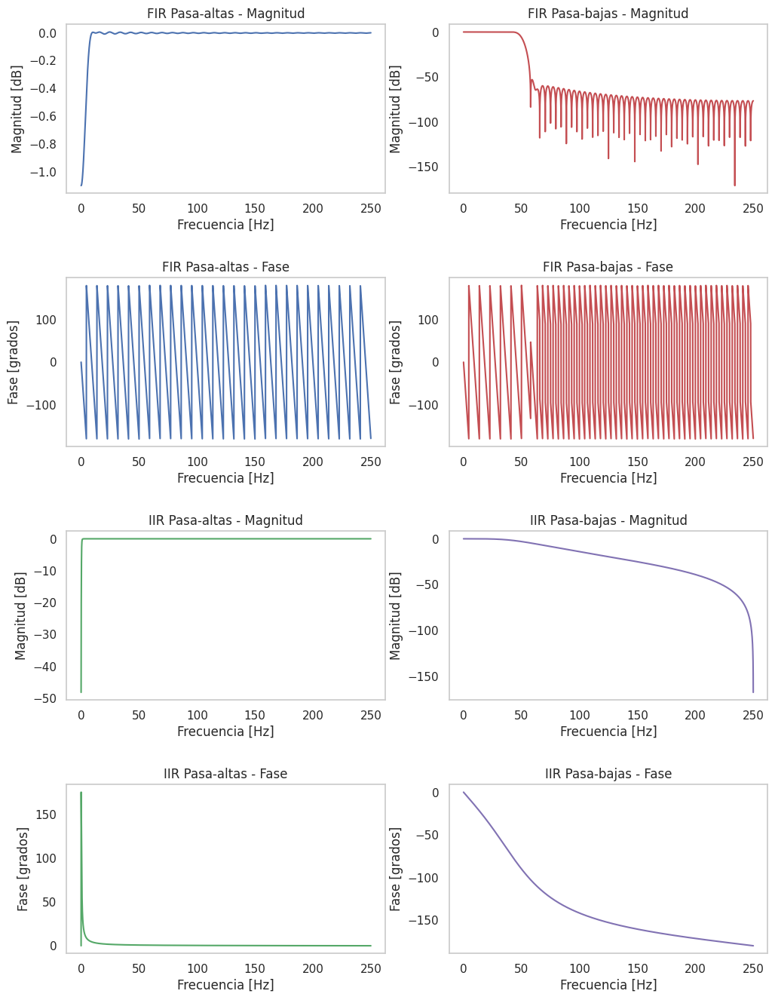

In [50]:
Fs = 500  # Frecuencia de muestreo
nyquist = Fs / 2
freqRech = 15 / Fs
orden_fir = int(np.floor(3.3 / freqRech)) | 1  # Asegura que el orden sea impar

# Diseño de Filtros FIR
bcof_hp = signal.firwin(orden_fir, 0.5 / nyquist, pass_zero='highpass', window='hamming')
bcof_lp = signal.firwin(orden_fir, 50 / nyquist, pass_zero='lowpass', window='hamming')

# Diseño de Filtros IIR

b_hp,a_hp=signal.iirfilter(2, 0.5 / nyquist, btype='high', ftype='butter')
b_lp,a_lp=signal.iirfilter(2, 50 / nyquist, btype='low', ftype='butter')


# Función para graficar respuesta de magnitud y fase en grados
def plot_response(axs, w, h, row, col, title, color):
    # Magnitud
    axs[row, col].plot(w, 20 * np.log10(abs(h)), color)
    axs[row, col].set_title(f"{title} - Magnitud")
    axs[row, col].set_xlabel("Frecuencia [Hz]")
    axs[row, col].set_ylabel("Magnitud [dB]")
    axs[row, col].grid()

    # Fase en grados
    phase_degrees = np.angle(h) * (180 / np.pi)
    axs[row + 1, col].plot(w, phase_degrees, color)
    axs[row + 1, col].set_title(f"{title} - Fase")
    axs[row + 1, col].set_xlabel("Frecuencia [Hz]")
    axs[row + 1, col].set_ylabel("Fase [grados]")
    axs[row + 1, col].grid()

# Configuración de subplots
fig, axs = plt.subplots(4, 2, figsize=(12, 16))
fig.subplots_adjust(hspace=0.5)

# Respuestas de filtros FIR
plot_response(axs, *signal.freqz(bcof_hp, worN=8000, fs=Fs), 0, 0, "FIR Pasa-altas", 'b')
plot_response(axs, *signal.freqz(bcof_lp, worN=8000, fs=Fs), 0, 1, "FIR Pasa-bajas", 'r')

# Respuestas de filtros IIR
plot_response(axs, *signal.freqz(b_hp, a_hp, worN=8000, fs=Fs), 2, 0, "IIR Pasa-altas", 'g')
plot_response(axs, *signal.freqz(b_lp, a_lp, worN=8000, fs=Fs), 2, 1, "IIR Pasa-bajas", 'm')

plt.show()

#**Flujos**


El primer flujo incluye el uso de dos filtros: un pasaaltas y un pasabajas, para el diseño de un filtro pasabandas. Además, incorpora un filtrado no lineal basado en la transformada wavelet Haar. Para este tipo de filtrado, se determinaron los niveles de descomposición en función del tamaño de la señal de aproximación y de la señal de ECG. La señal wavelet utilizada es la Bior6.8 [3], que se destaca por su similitud con el ECG y su diseño específico para el análisis de estas señales, superando en adecuación a otras opciones como Sym y db.

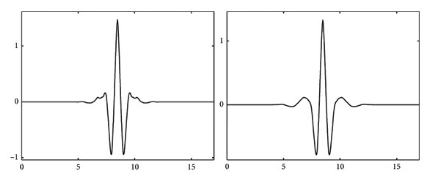
Figura 1. Señal Wavelet Bior6.8 [3]

In [51]:
def flujo1(ecg, Fs):  # Asegúrate de que level tenga un valor predeterminado o lo pases como argumento# Frecuencia de muestreo en Hz
    fc = 0.5  # Frecuencia de corte en Hz
    order = 4  # Orden del filtro (ajustable para obtener la respuesta deseada)
    # Normalizar la frecuencia de corte respecto a Nyquist
    nyquist = Fs / 2
    highCutN = fc / nyquist

    # Diseñar el filtro IIR Butterworth de paso alto

    b,a=signal.iirfilter(order, highCutN, btype='high', ftype='butter')

    # Aplicar el filtro IIR a la señal de ECG con filtfilt para evitar desfase
    y_filtered = signal.filtfilt(b, a, ecg)
    # Descomposición wavelet
    wavelet = 'bior6.8'
    level = pywt.dwt_max_level(len(y_filtered), pywt.Wavelet(wavelet))
    data_wavelet = pywt.wavedec(y_filtered, 'bior6.8',level=level)
    details = data_wavelet[1:]

    # Asegúrate de que wthresh esté definida y retorne los valores esperados
    thr, s, y = wthresh(details)

    # Construir la lista de coeficientes para la reconstrucción
    coeff = [data_wavelet[0]] + list(y)  # Aproximación y detalles

    # Reconstruir la señal
    y_filtered_reconstructed = pywt.waverec(coeff, 'bior6.8')

    # Cálculo del orden del filtro pasa-bajas
    freqRech = 15/ 500
    orden = int(np.floor(3.3 / freqRech))  # Convierte a entero

    # Asegurarse de que el orden sea impar
    if orden % 2 == 0:
        orden += 1

    # Filtrado pasa-bajas
    lowCutN = 50 / nyquist
    bcof = signal.firwin(orden, lowCutN, pass_zero='lowpass', window='hamming')
    y_final = signal.filtfilt(bcof, a=1, x=y_filtered_reconstructed)

    return y_final

Flujo 2, cuenta con un wavelet con la señal bior6.8, un pasa bajas tipo fir y un detrend de tendencia lineal

In [52]:
def flujo2(ecg,Fs):
  ecg_detrended = detrend(ecg)
  wavelet = 'bior6.8'
  level = pywt.dwt_max_level(len(ecg_detrended), pywt.Wavelet(wavelet))
  data_wavelet = pywt.wavedec( ecg_detrended, 'bior6.8', level=level )
  details = data_wavelet[1:]
  thr, s, y = wthresh(details);
  coeff = list()
  coeff.append(data_wavelet[0])

  for i in range(len(y)):
      coeff.append(y[i])
  y_filtered2 = pywt.waverec( coeff, 'bior6.8');
  nyquist = Fs / 2
  freqRech = 15/ Fs
  orden = int(np.floor(3.3 / freqRech))  # Convierte a entero

    # Asegurarse de que el orden sea impar
  if orden % 2 == 0:
      orden += 1

    # Filtrado pasa-bajas
  lowCutN = 50 / nyquist
  bcof = signal.firwin(orden, lowCutN, pass_zero='lowpass', window='hamming')
  y_final2 = signal.filtfilt(bcof, a=1, x=y_filtered2)

  return y_final2

FLujo 3, solo cuenta dos tipos de filtros un pasa altas tipo IIR y un filtro pasa bajas tipo FIR

In [53]:
def flujo3(ecg, Fs):  # Asegúrate de que level tenga un valor predeterminado o lo pases como argumento
    freqRech = 15 / Fs
    orden = int(np.floor(5.5 / freqRech))  # Convierte a entero

    # Asegurarse de que el orden sea impar
    if orden % 2 == 0:
        orden += 1

    fc = 0.5  # Frecuencia de corte en Hz
    order = 4  # Orden del filtro (ajustable para obtener la respuesta deseada)
    # Normalizar la frecuencia de corte respecto a Nyquist
    nyquist = Fs / 2
    highCutN = fc / nyquist

    # Diseñar el filtro IIR Butterworth de paso alto
    b,a=signal.iirfilter(order, highCutN, btype='high', ftype='butter')

    y_filtered = signal.filtfilt(b, a, ecg)
    # Filtrado pasa-bajas
    lowCutN = 50 / nyquist
    bcof = signal.firwin(orden, lowCutN, pass_zero='lowpass', window='hamming')
    y_final = signal.filtfilt(bcof, a=1, x=y_filtered)

    return y_final



In [54]:
def calcular_similitud(senal_a, senal_b):
    correlacion = np.corrcoef(senal_a, senal_b)[0, 1]
    mse = np.mean((senal_a - senal_b) ** 2)
    return correlacion, mse

#**Comparacion de Flujos**

Correlacion diseñada con las señales del proyecto aplicando los tres flujos contra las señales ya filtradas del proyecto 2

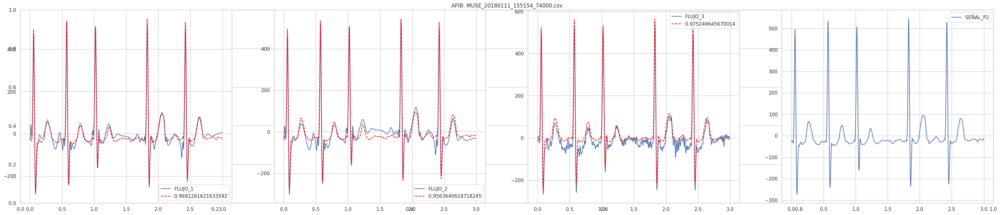

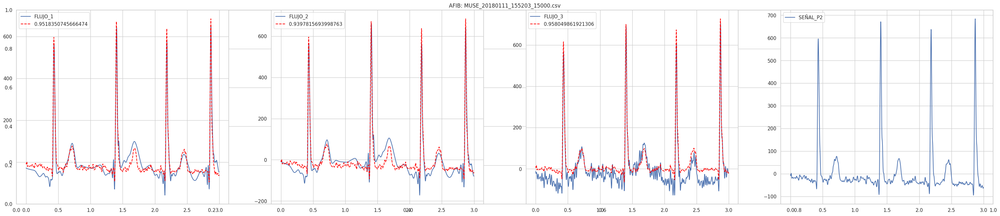

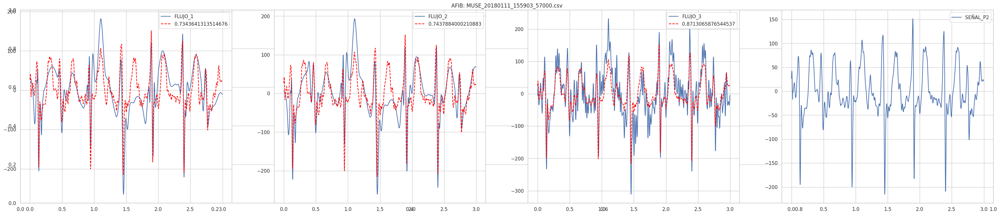

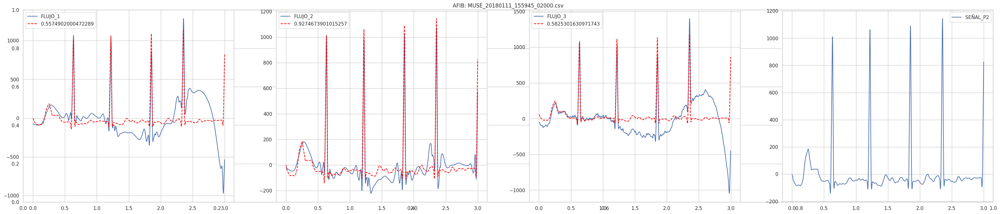

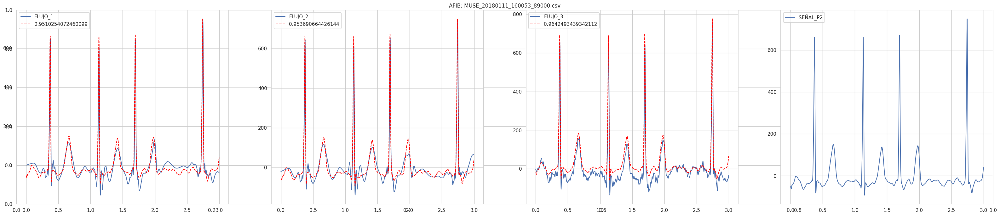

...

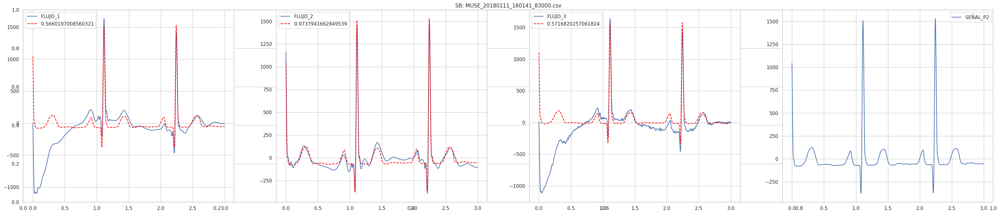

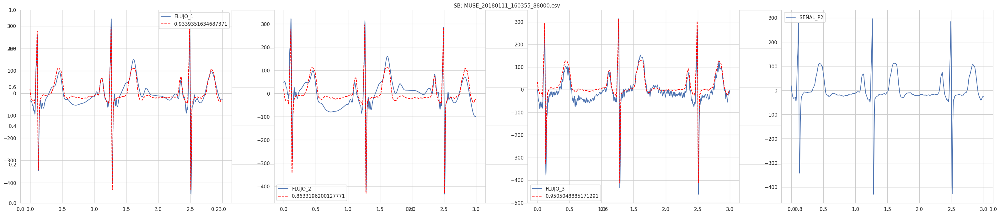

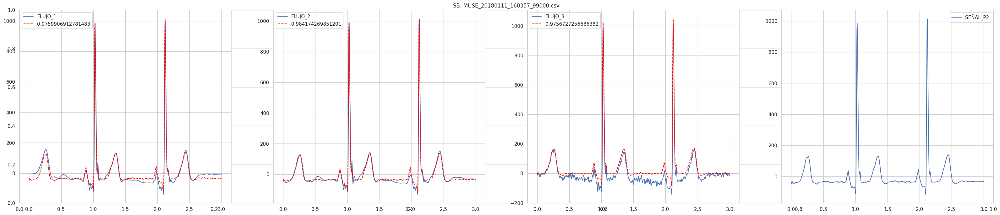

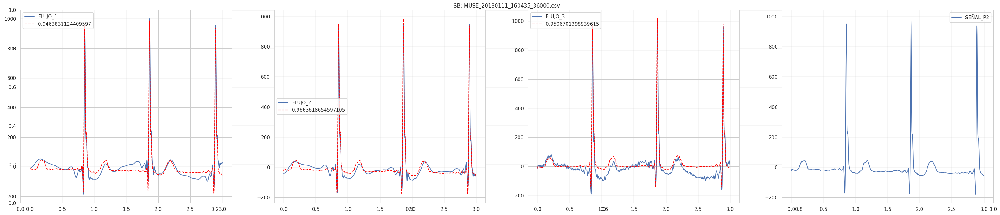

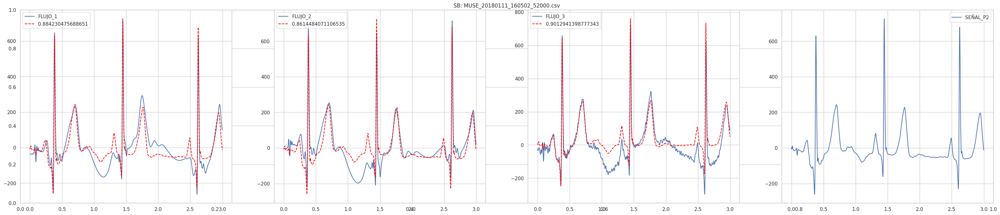

In [55]:
senales_AFIB = []
senales_SB = []

for k in range(2):
    if k == 0:
        title = "AFIB: "
        senales_actuales = senales_AFIB
    else:
        title = "SB: "
        senales_actuales = senales_SB

    for i in range(10):
        plt.figure(figsize=(40, 8))
        plt.title(title + registros[k][i])

        senal_filtrada = []

        plt.subplot(1, 4, 1)
        y_final = flujo1(Estados[k][i][:1500], 500)
        correlacion, mse = calcular_similitud(EstadosFil[k][i][:1500], y_final)
        plt.plot(tiempo[:1500], y_final, label="FLUJO_1")
        plt.plot(tiempo[:1500], detrend(EstadosFil[k][i][:1500]), label=str(correlacion), color="red", linestyle="--")
        plt.legend()
        senal_filtrada.append(y_final)

        plt.subplot(1, 4, 2)
        y_final2 = flujo2(Estados[k][i][:1500], 500)
        correlacion, mse = calcular_similitud(EstadosFil[k][i][:1500], y_final2)
        plt.plot(tiempo[:1500], y_final2, label="FLUJO_2")
        plt.plot(tiempo[:1500], detrend(EstadosFil[k][i][:1500]), label=str(correlacion), color="red", linestyle="--")
        plt.legend()
        senal_filtrada.append(y_final2)

        plt.subplot(1, 4, 3)
        y_final3 = flujo3(Estados[k][i][:1500], 500)
        correlacion, mse = calcular_similitud(EstadosFil[k][i][:1500], y_final3)
        plt.plot(tiempo[:1500], y_final3, label="FLUJO_3")
        plt.plot(tiempo[:1500], EstadosFil[k][i][:1500], label=str(correlacion), color="red", linestyle="--")
        plt.legend()
        senal_filtrada.append(y_final3)

        plt.subplot(1, 4, 4)
        plt.plot(tiempo[:1500], detrend(EstadosFil[k][i][:1500]), label="SEÑAL_P2")
        plt.legend()
        plt.show()
        senales_actuales.append(senal_filtrada)


Correlacion de igual forma con los tres flujos, pero, contra as señales del mismo proyecto 3 para visualizar que tanto correlacionan con el ruido

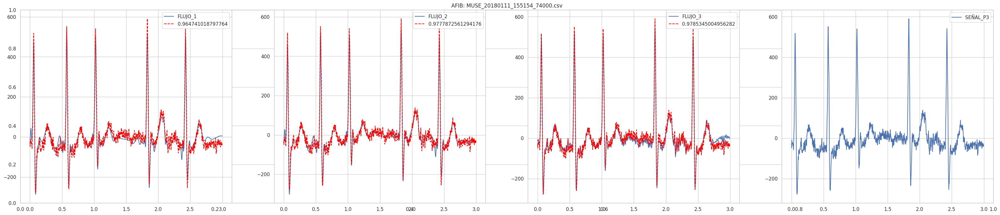

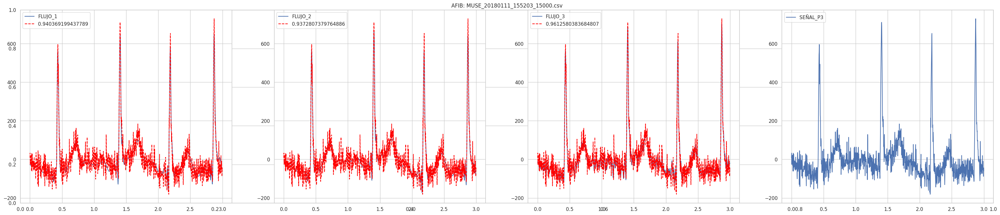

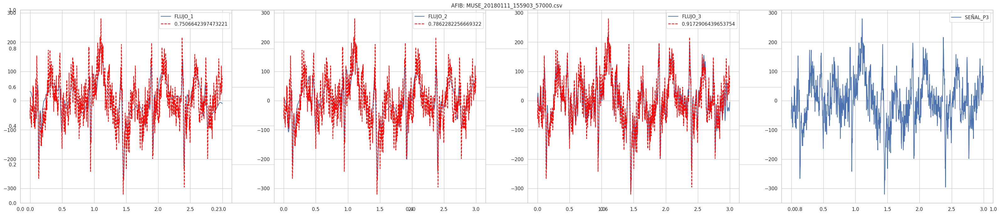

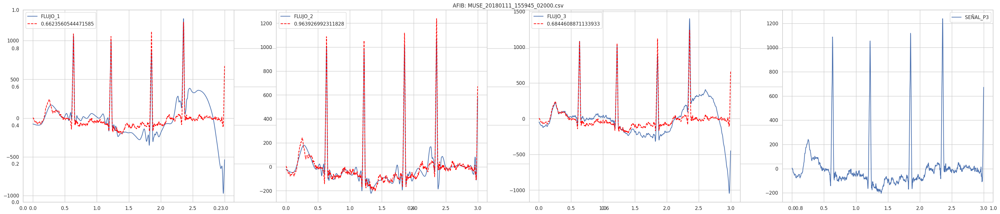

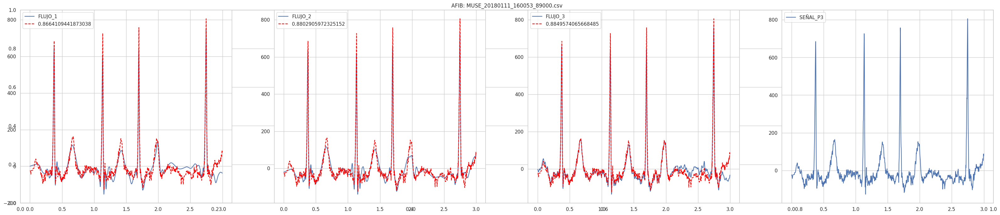

...

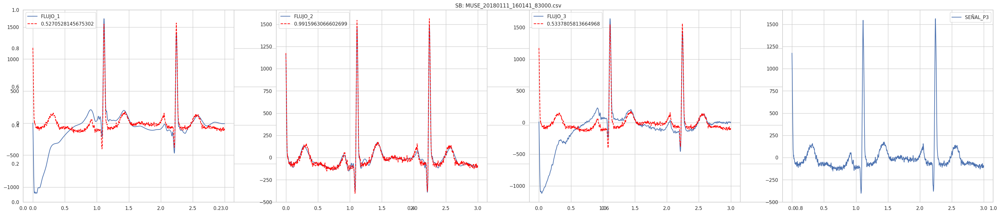

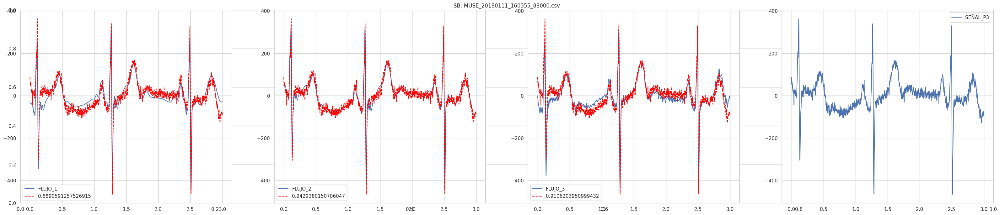

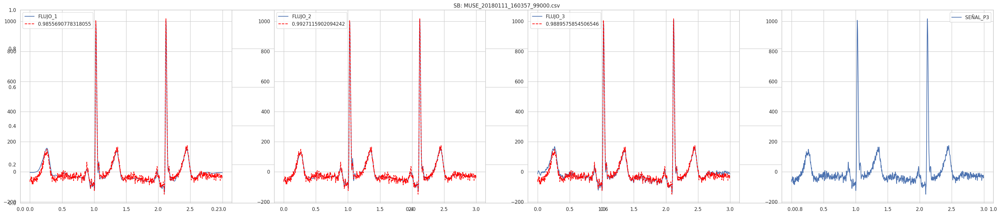

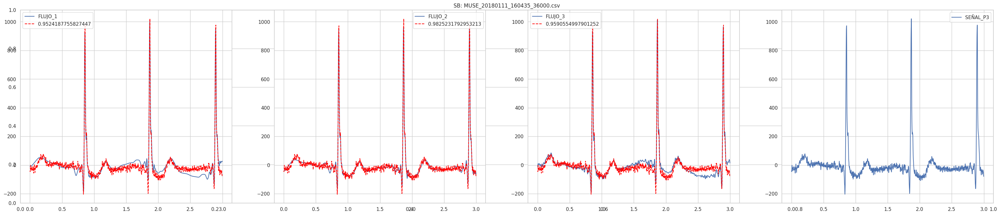

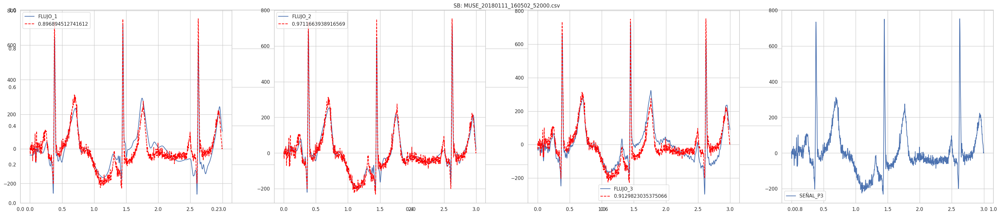

In [56]:
senales_AFIB = []
senales_SB = []

for k in range(2):
    if k == 0:
        title = "AFIB: "
        senales_actuales = senales_AFIB
    else:
        title = "SB: "
        senales_actuales = senales_SB

    for i in range(10):
        plt.figure(figsize=(40, 8))
        plt.title(title + registros[k][i])

        senal_filtrada = []

        plt.subplot(1, 4, 1)
        y_final = flujo1(Estados[k][i][:1500], 500)
        correlacion, mse = calcular_similitud(Estados[k][i][:1500], y_final)
        plt.plot(tiempo[:1500], y_final, label="FLUJO_1")
        plt.plot(tiempo[:1500], detrend(Estados[k][i][:1500]), label=str(correlacion), color="red", linestyle="--")
        plt.legend()
        senal_filtrada.append(y_final)

        plt.subplot(1, 4, 2)
        y_final2 = flujo2(Estados[k][i][:1500], 500)
        correlacion, mse = calcular_similitud(Estados[k][i][:1500], y_final2)
        plt.plot(tiempo[:1500], y_final2, label="FLUJO_2")
        plt.plot(tiempo[:1500], detrend(Estados[k][i][:1500]), label=str(correlacion), color="red", linestyle="--")
        plt.legend()
        senal_filtrada.append(y_final2)

        plt.subplot(1, 4, 3)
        y_final3 = flujo3(Estados[k][i][:1500], 500)
        correlacion, mse = calcular_similitud(Estados[k][i][:1500], y_final3)
        plt.plot(tiempo[:1500], y_final3, label="FLUJO_3")
        plt.plot(tiempo[:1500], detrend(Estados[k][i][:1500]), label=str(correlacion), color="red", linestyle="--")
        plt.legend()
        senal_filtrada.append(y_final3)

        plt.subplot(1, 4, 4)
        plt.plot(tiempo[:1500], detrend(Estados[k][i][:1500]), label="SEÑAL_P3")
        plt.legend()
        plt.show()
        senales_actuales.append(senal_filtrada)

Funcion utilizada para obtenciòn de la Maxima frecuencia de las señales filtradas en el proyecto 3

In [57]:
def obtener_frecuencia_maxima(signal, fs):

    # Aplicar el método de Welch
    frecuencias, Pxx = welch(signal, fs, window='hann', nperseg=2048, noverlap=1024)
    # Encontrar la frecuencia de máxima potencia
    max_idx = np.argmax(Pxx)
    max_freq = frecuencias[max_idx]
    return max_freq


In [58]:
# Dataframe con los registros de cada señal
DatosMaximas=pd.read_excel('/content/drive/MyDrive/Proyecto_3/DataFrame_SujetosP2.xlsx')
df_FreqAfib=DatosMaximas[DatosMaximas['ESTADO'] == 'AFIB']
ListaMaximasF1 = df_FreqAfib['FMP'].tolist()
df_FreqSB=DatosMaximas[DatosMaximas['ESTADO'] == 'SB']
ListaMaximasF2 = df_FreqSB['FMP'].tolist()


#**Main del Filtrado de Datos**

In [59]:
ListaFrecuenciasECG1=[]
ListaFrecuenciasECG2=[]
for i in range(len(ListaValoresECG1)):
  filtro=flujo2(ListaValoresECG1[i],500)
  frecuencia1=obtener_frecuencia_maxima(filtro,500)
  frecuencia2=ListaMaximasF1[i]
  Registro=ListaRegistro1[i]
  ListaFrecuenciasECG1.append([Registro,"AFIB",frecuencia1,frecuencia2])
for i in range(len(ListaValoresECG2)):
  filtro=flujo2(ListaValoresECG2[i],500)
  frecuencia21=obtener_frecuencia_maxima(filtro,500)
  frecuencia22=ListaMaximasF2[i]
  Registro=ListaRegistro2[i]
  ListaFrecuenciasECG2.append([Registro,"SB",frecuencia21,frecuencia22])
print(len(ListaFrecuenciasECG1))
print(len(ListaFrecuenciasECG2))

1780
3889


In [60]:
df_ecg1 = pd.DataFrame(ListaFrecuenciasECG1, columns=["REGISTRO", "ESTADO", "FMP_P3", "FMP_P2"])
df_ecg2 = pd.DataFrame(ListaFrecuenciasECG2, columns=["REGISTRO", "ESTADO", "FMP_P3", "FMP_P2"])
df_combinado = pd.concat([df_ecg1, df_ecg2], ignore_index=True)
Hsujetos = (
    df_combinado.style
    .set_table_styles(
        [
            {
                'selector': 'thead th',
                'props': [
                    ('background-color', '#2c3e50'),
                    ('color', 'white'),
                    ('font-weight', 'bold'),
                    ('border', '1px solid #2980b9'),
                    ('text-align', 'center'),
                    ('vertical-align', 'middle')
                ]
            },
            {
                'selector': 'caption',
                'props': [
                    ('caption-side', 'top'),
                    ('font-size', '22px'),
                    ('background-color', '#2980b9'),
                    ('color', 'white'),
                    ('font-weight', 'bold'),
                    ('text-align', 'center'),
                    ('padding', '12px')
                ]
            },
            {
                'selector': 'tbody td',
                'props': [
                    ('border', '1px solid #bdc3c7'),
                    ('padding', '8px'),
                    ('text-align', 'center'),
                    ('vertical-align', 'middle')
                ]
            }
        ]
    )
    .background_gradient(cmap='Blues')
    .set_caption("SUJETOS")
    .set_table_attributes('style="width: 100%; max-width: 1500px; margin: auto;"')  # Ajusta el ancho del DataFrame
)

# Convertir a HTML y mostrar centrado
display(HTML(f"<div style='text-align: center; width: 100%;'>{Hsujetos.to_html()}</div>"))

#**Estadistica Descriptiva**

Grafica de caja y bigotes de cada patologia con los procesos de filtrado del proyecto 2 y 3

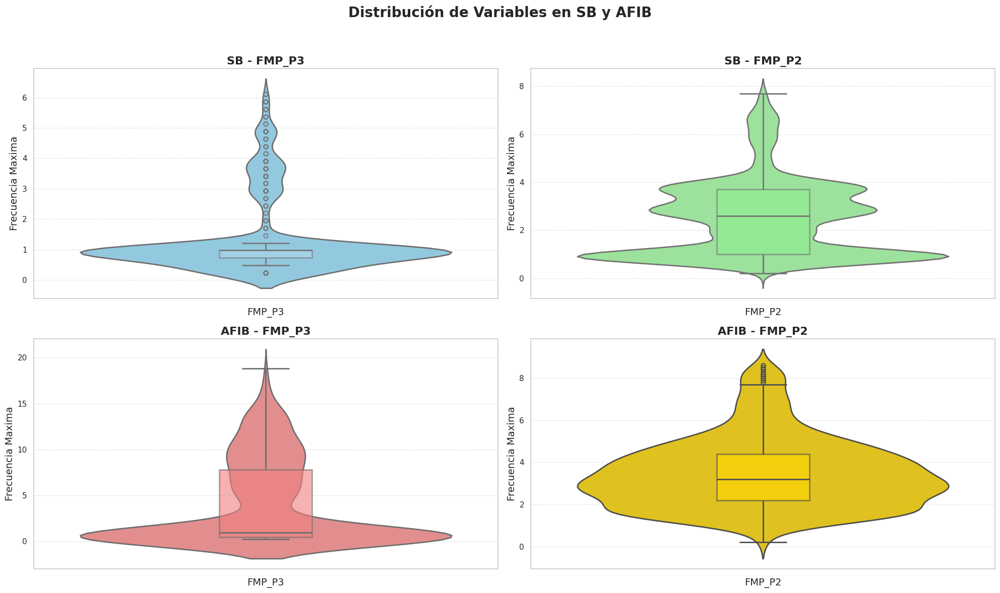

In [61]:
SB=df_combinado[df_combinado['ESTADO'] == 'SB']
AFIB=df_combinado[df_combinado['ESTADO'] == 'AFIB']
SB_FMP3_clean = eliminar_outliers(SB["FMP_P3"])
AFIB_FMP3_clean = eliminar_outliers(AFIB["FMP_P3"])
SB_FMP2_clean = eliminar_outliers(SB["FMP_P2"])
AFIB_FMP2_clean = eliminar_outliers(AFIB["FMP_P2"])

# Establecer el estilo de Seaborn
sns.set(style="whitegrid", palette="pastel")

# Datos y títulos para los gráficos
data_titles = [
    (SB_FMP3_clean, "SB - FMP_P3", "FMP_P3", "Frecuencia Maxima", "skyblue", "lightblue"),
    (SB_FMP2_clean, "SB - FMP_P2", "FMP_P2", "Frecuencia Maxima", "lightgreen", "lightgreen"),
    (AFIB_FMP3_clean, "AFIB - FMP_P3", "FMP_P3", "Frecuencia Maxima","lightcoral", "lightcoral"),
    (AFIB_FMP2_clean, "AFIB - FMP_P2", "FMP_P2", "Frecuencia Maxima", "gold", "gold")
]

# Graficar sin outliers
plt.figure(figsize=(20, 12))
plt.suptitle("Distribución de Variables en SB y AFIB", fontsize=20, fontweight='bold')

for i, (data, title, xlabel, ylabel, violin_color, box_color) in enumerate(data_titles):
    plt.subplot(2, 2, i + 1)
    sns.violinplot(data=data, color=violin_color, inner=None, linewidth=2)
    sns.boxplot(data=data, width=0.2, boxprops=dict(facecolor=box_color, alpha=0.6), color=box_color, linewidth=2)
    plt.title(title, fontsize=16, fontweight='bold')
    plt.xlabel(xlabel, fontsize=14)
    plt.ylabel(ylabel, fontsize=14)
    plt.grid(axis='y', linestyle='--', alpha=0.5)

plt.tight_layout(rect=[0, 0, 1, 0.95])  # Ajustar el espacio para el título general
plt.show()

Histogramas que comparan la distribucion de las frecuencias con respecto al tipo de filtrado, para cada patologia

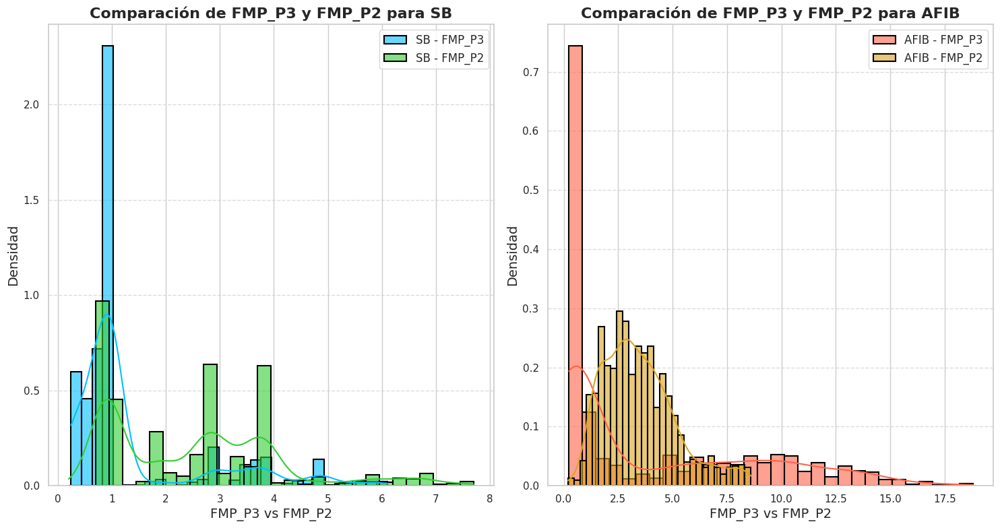

In [62]:
# Definir los datos de FMP_P3 y FMP_P2 para cada enfermedad (SB y AFIB)
variables = [
    ("FMP_P3", SB["FMP_P3"], AFIB["FMP_P3"]),
    ("FMP_P2", SB["FMP_P2"], AFIB["FMP_P2"])
]

# Limpiar datos eliminando outliers
cleaned_data_sb = [eliminar_outliers(sb) for _, sb, _ in variables]
cleaned_data_afib = [eliminar_outliers(afib) for _, _, afib in variables]

# Graficar histogramas y KDE sin outliers
plt.figure(figsize=(15, 8))
sns.set(style="whitegrid")  # Estilo general de la gráfica
# Configuración de los títulos y colores para las gráficas
titles = ["Comparación de FMP_P3 y FMP_P2 para SB", "Comparación de FMP_P3 y FMP_P2 para AFIB"]
colors = [("deepskyblue", "limegreen"), ("tomato", "goldenrod")]

# Gráfica para SB
plt.subplot(1, 2, 1)
for i, sb_clean in enumerate(cleaned_data_sb):
    sns.histplot(sb_clean, bins=30, color=colors[0][i], kde=True, stat="density", label=f"SB - {variables[i][0]}", alpha=0.6, linewidth=1.5, edgecolor='black')
plt.title(titles[0], fontsize=16, fontweight='bold')
plt.xlabel("FMP_P3 vs FMP_P2", fontsize=14)
plt.ylabel("Densidad", fontsize=14)
plt.legend(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Gráfica para AFIB
plt.subplot(1, 2, 2)
for i, afib_clean in enumerate(cleaned_data_afib):
    sns.histplot(afib_clean, bins=30, color=colors[1][i], kde=True, stat="density", label=f"AFIB - {variables[i][0]}", alpha=0.6, linewidth=1.5, edgecolor='black')
plt.title(titles[1], fontsize=16, fontweight='bold')
plt.xlabel("FMP_P3 vs FMP_P2", fontsize=14)
plt.ylabel("Densidad", fontsize=14)
plt.legend(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Ajustar el layout
plt.tight_layout()
plt.show()


#**Estadistica Inferencial**

Pruebas de normalidad, Kolmogorov, para visualizar el tipo de distribuciòn de las señales, clasificadas entre las patologias y tipo de filtrado, es decir proyecto 2 y 3, la prueba de levene para visualizar la homocedasticidad de cada patologia y ver como se comporta su varianza

Normalidad:
- Hipótesis nula (H₀): Los datos provienen de una distribución normal.
- Hipótesis alternativa (H₁): Los datos no provienen de una distribución normal.

Homocedasticidad:
- Hipótesis nula (H₀): los datos poseen homocedasticidad.
- Hipótesis alternativa (H₁): Los datos no poseen homocedasticidad .

In [63]:
import pandas as pd
from scipy import stats

# Realizar los tests de Kolmogorov-Smirnov para FMP_P3 y FMP_P2 en SB y AFIB
ks_stat_FMP_P3_SB, ks_p_FMP_P3_SB = stats.kstest(SB['FMP_P3'], 'norm', args=(SB['FMP_P3'].mean(), SB['FMP_P3'].std()))
ks_stat_FMP_P2_SB, ks_p_FMP_P2_SB = stats.kstest(SB['FMP_P2'], 'norm', args=(SB['FMP_P2'].mean(), SB['FMP_P2'].std()))
ks_stat_FMP_P3_AFIB, ks_p_FMP_P3_AFIB = stats.kstest(AFIB['FMP_P3'], 'norm', args=(AFIB['FMP_P3'].mean(), AFIB['FMP_P3'].std()))
ks_stat_FMP_P2_AFIB, ks_p_FMP_P2_AFIB = stats.kstest(AFIB['FMP_P2'], 'norm', args=(AFIB['FMP_P2'].mean(), AFIB['FMP_P2'].std()))

# Crear un DataFrame con los resultados
data = {
    'Estado': ['SB', 'SB', 'AFIB', 'AFIB'],
    'Variable': ['FMP_P3', 'FMP_P2', 'FMP_P3', 'FMP_P2'],
    'Statistic': [ks_stat_FMP_P3_SB, ks_stat_FMP_P2_SB, ks_stat_FMP_P3_AFIB, ks_stat_FMP_P2_AFIB],
    'p-value': [ks_p_FMP_P3_SB, ks_p_FMP_P2_SB, ks_p_FMP_P3_AFIB, ks_p_FMP_P2_AFIB],
    'Normalidad': [
        'No se rechaza H0' if p > 0.05 else 'Se rechaza H0' for p in [ks_p_FMP_P3_SB, ks_p_FMP_P2_SB, ks_p_FMP_P3_AFIB, ks_p_FMP_P2_AFIB]
    ]
}

df = pd.DataFrame(data)

# Aplicar estilo a la tabla solo para visualización
styled_df = df.style.applymap(lambda x: 'background-color: lightgreen' if x == 'No se rechaza H0' else 'background-color: lightcoral', subset=['Normalidad']) \
                    .format({'Statistic': '{:.4f}', 'p-value': '{:.4e}'}) \
                    .set_caption('Resultados del Test de Kolmogorov-Smirnov para FMP_P3 y FMP_P2 en SB y AFIB') \
                    .set_table_attributes('style="margin: auto; width: 80%;"')

# Guardar el DataFrame en un archivo Excel (sin estilo)
output_file = 'kolmogorov_smirnov_results.xlsx'
with pd.ExcelWriter(output_file, engine='openpyxl') as writer:
    df.to_excel(writer, sheet_name='Resultados', index=False)

# Mostrar el DataFrame estilizado en pantalla
display(styled_df)


<ipython-input-63-f7f74ac173b3>:24: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_df = df.style.applymap(lambda x: 'background-color: lightgreen' if x == 'No se rechaza H0' else 'background-color: lightcoral', subset=['Normalidad']) \


,Estado,Variable,Statistic,p-value,Normalidad
0,SB,FMP_P3,0.3880,0.0000e+00,Se rechaza H0
1,SB,FMP_P2,0.2041,1.7705e-142,Se rechaza H0
2,AFIB,FMP_P3,0.2550,1.6843e-102,Se rechaza H0
3,AFIB,FMP_P2,0.1847,1.2430e-53,Se rechaza H0


In [64]:
import pandas as pd
from scipy import stats

# Realizar la prueba de Levene para FMP_P2 y FMP_P3 en cada enfermedad (SB y AFIB)
levene_stat_SB, levene_p_SB = stats.levene(SB['FMP_P3'], SB['FMP_P2'])
levene_stat_AFIB, levene_p_AFIB = stats.levene(AFIB['FMP_P3'], AFIB['FMP_P2'])

# Crear un DataFrame con los resultados
data = {
    'Enfermedad': ['SB', 'AFIB'],
    'Variable': ['FMP_P3 vs FMP_P2', 'FMP_P3 vs FMP_P2'],
    'Statistic': [levene_stat_SB, levene_stat_AFIB],
    'p-value': [levene_p_SB, levene_p_AFIB],
    'Homocedasticidad': [
        'No se rechaza H0' if p > 0.05 else 'Se rechaza H0' for p in [levene_p_SB, levene_p_AFIB]
    ]
}

df = pd.DataFrame(data)

# Aplicar estilo a la tabla solo para visualización
styled_df = df.style.applymap(lambda x: 'background-color: lightgreen' if x == 'No se rechaza H0' else 'background-color: lightcoral', subset=['Homocedasticidad']) \
                    .format({'Statistic': '{:.4f}', 'p-value': '{:.4e}'}) \
                    .set_caption('Resultados de la Prueba de Levene para FMP_P3 y FMP_P2 en SB y AFIB') \
                    .set_table_attributes('style="margin: auto; width: 50%;"')

# Guardar el DataFrame en un archivo Excel (sin estilo)
output_file = 'levene_results.xlsx'
with pd.ExcelWriter(output_file, engine='openpyxl') as writer:
    df.to_excel(writer, sheet_name='Resultados', index=False)

# Mostrar el DataFrame estilizado en pantalla
display(styled_df)



<ipython-input-64-533aeff55b9c>:22: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_df = df.style.applymap(lambda x: 'background-color: lightgreen' if x == 'No se rechaza H0' else 'background-color: lightcoral', subset=['Homocedasticidad']) \


,Enfermedad,Variable,Statistic,p-value,Homocedasticidad
0,SB,FMP_P3 vs FMP_P2,4.1653,4.1294e-02,Se rechaza H0
1,AFIB,FMP_P3 vs FMP_P2,193.2207,8.1366e-43,Se rechaza H0


Prueba de U, no parametrica, para la comparacion de medianas de los dos tipos de filtrado para cada patologia, las hipotesis son las siguentes:
- Hipótesis nula (H₀): No hay diferencias significativas entre las medianas de las frecuencias máximas de potencia en los conjuntos de señales para cada patología, lo que sugeriría que el tipo de filtrado no afecta a este parámetro.
- Hipótesis alternativa (H₁): Existen diferencias significativas entre las medianas de las frecuencias máximas de potencia en los conjuntos de señales, lo que indicaría una posible influencia del tipo de filtrado sobre este parámetro.

In [65]:
mannwhitney_sfsb = stats.mannwhitneyu(SB['FMP_P3'], SB['FMP_P2'], alternative='two-sided')
mannwhitney_fmp = stats.mannwhitneyu(AFIB['FMP_P3'], AFIB['FMP_P2'], alternative='two-sided')

# Crear un DataFrame con los resultados
data = {
    'Variable': ['SB', 'AFIB'],
    'U-statistic': [mannwhitney_sfsb.statistic, mannwhitney_fmp.statistic],
    'p-value': [mannwhitney_sfsb.pvalue, mannwhitney_fmp.pvalue],
    'Igualdad de Medianas': [
        'No se rechaza H0' if p > 0.05 else 'Se rechaza H0' for p in [mannwhitney_sfsb.pvalue, mannwhitney_fmp.pvalue]
    ]
}

df = pd.DataFrame(data)

# Aplicar estilo a la tabla
styled_df = df.style.applymap(lambda x: 'background-color: lightgreen' if x == 'No se rechaza H0' else 'background-color: lightcoral', subset=['Igualdad de Medianas']) \
                    .format({'U-statistic': '{:.4f}', 'p-value': '{:.4e}'}) \
                    .set_caption('Resultados de la Prueba U de Mann-Whitney') \
                    .set_table_attributes('style="margin: auto; width: 50%;"')  # Centrar la tabla

# Guardar la tabla estilizada en un archivo Excel
output_file = 'mannwhitney_results.xlsx'
with pd.ExcelWriter(output_file, engine='openpyxl') as writer:
    styled_df.to_excel(writer, sheet_name='Resultados', index=False)

# Mostrar el DataFrame estilizado
display(styled_df)


<ipython-input-65-763c2735124c>:17: FutureWarning: Styler.applymap has been deprecated. Use Styler.map instead.
  styled_df = df.style.applymap(lambda x: 'background-color: lightgreen' if x == 'No se rechaza H0' else 'background-color: lightcoral', subset=['Igualdad de Medianas']) \


,Variable,U-statistic,p-value,Igualdad de Medianas
0,SB,4987803.0000,1.6243e-150,Se rechaza H0
1,AFIB,1202455.0000,1.2274e-35,Se rechaza H0


#**Ejemplo de Robust LOESS y NLM**

Son dos tipos de metodos aplicados a travès de ventanas para la reducciòn del ruido y de valores atipicos para la mejora de la calidad de una señal o conjunto de datos, en el caso de NLM se puede aplicar en imagenes, con arreglos matriciales[4]. se usa la alineacion de tendencia y distribucion de peso de datos para descartar valores que no tengan alguna relaciòn con el conjunto de datos completo

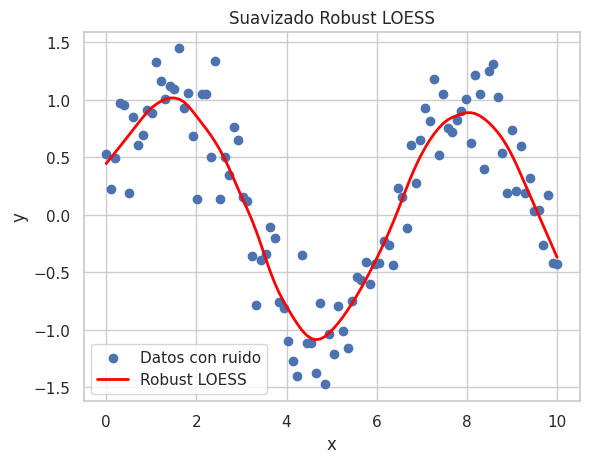

In [81]:
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm

# Generar datos simulados
np.random.seed(0)
x = np.linspace(0, 10, 100)
y = np.sin(x) + np.random.normal(scale=0.3, size=len(x))

# Aplicar suavizado LOESS robusto
lowess = sm.nonparametric.lowess(y, x, frac=0.2, it=3)  # 'frac' controla el tamaño de la ventana, 'it' para robustez

# Graficar los resultados
plt.scatter(x, y, label='Datos con ruido')
plt.plot(lowess[:, 0], lowess[:, 1], color='red', label='Robust LOESS', linewidth=2)
plt.xlabel('x')
plt.ylabel('y')
plt.title('Suavizado Robust LOESS')
plt.legend()
plt.show()


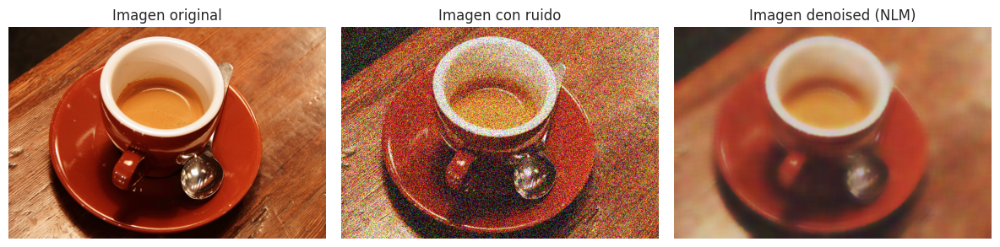

In [80]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import data
from skimage.restoration import denoise_nl_means, estimate_sigma
from skimage import img_as_float

# Cargar una imagen de ejemplo a color (puedes usar cualquier imagen RGB)
image = data.coffee()  # Imagen de ejemplo a color

# Convertir la imagen a float64 (para evitar problemas con el rango de valores de píxeles)
image = img_as_float(image)

# Agregar más ruido gaussiano a la imagen para que la diferencia sea visible
np.random.seed(0)
noisy_image = image + 0.3 * np.random.standard_normal(image.shape)  # Ruido más fuerte

# Asegurarnos de que los valores estén dentro del rango [0, 1]
noisy_image = np.clip(noisy_image, 0, 1)

# Estimación del ruido (sigma) para cada canal de la imagen
sigma_est = np.mean([estimate_sigma(noisy_image[:, :, i]) for i in range(3)])

# Aplicar Non-Local Means (NLM) para cada canal de la imagen con parámetros ajustados
denoised_image = np.zeros_like(noisy_image)

for i in range(3):  # Procesar cada canal (R, G, B) por separado
    denoised_image[:, :, i] = denoise_nl_means(noisy_image[:, :, i], h=1.5 * sigma_est, sigma=sigma_est, fast_mode=True, patch_size=7, patch_distance=11)

# Mostrar los resultados
fig, axes = plt.subplots(1, 3, figsize=(12, 6))
ax = axes.ravel()

ax[0].imshow(image)
ax[0].set_title('Imagen original')
ax[0].axis('off')

ax[1].imshow(noisy_image)
ax[1].set_title('Imagen con ruido')
ax[1].axis('off')

ax[2].imshow(denoised_image)
ax[2].set_title('Imagen denoised (NLM)')
ax[2].axis('off')

plt.tight_layout()
plt.show()



#**Conclusiones**


- Diferencias en la eficiencia de los filtros: Los filtros IIR y FIR mostraron distintas características en cuanto a orden y eficiencia. Los IIR, a pesar de requerir órdenes más bajos y ser efectivos en frecuencias bajas, pierden precisión de fase en frecuencias altas. Los FIR, aunque necesitan un orden más alto, conservan una respuesta de fase lineal en frecuencias elevadas, lo que justifica el uso de una estrategia combinada para aprovechar las ventajas de ambos.

- Impacto del filtrado en la morfología de las señales: El análisis evidenció que el flujo de procesamiento y las técnicas de filtrado aplicadas afectan la estructura de la señal de manera diferente. Por ejemplo, la técnica wavelet aplicada en el flujo 1, aunque efectiva para reducir el ruido, conlleva una leve alteración en la forma original de la señal, mientras que el flujo 3, sin wavelet, conserva mejor la forma, pero con más ruido.

- Adaptabilidad de los filtros según la patología: La respuesta al filtrado varía según la patología. En el caso de la SB, los filtros utilizados en el flujo experimental lograron minimizar la dispersión de los datos, lo que indica un tratamiento más coherente de la señal. En contraste, las señales de AFIB, debido a su naturaleza caótica, experimentaron mayor dispersión tras el filtrado, demostrando que los métodos aplicados no siempre son eficaces para patologías con alta variabilidad.

- Sensibilidad a la variabilidad de la señal: Las herramientas de filtrado, en especial las aproximaciones wavelet, demostraron ser sensibles a la variabilidad de la señal. Las señales con mayor caoticidad y dispersión, como la AFIB, presentaron limitaciones en la efectividad del filtrado, evidenciando que estas técnicas pueden no ser las más adecuadas cuando se busca una representación fiel y menos ruidosa en contextos de alta irregularidad.


#**Referencias**



[1]	«Linear Filters | Introduction to Digital Filters». Accedido: 7 de noviembre de 2024. [En línea]. Disponible en: https://www.dsprelated.com/freebooks/filters/Linear_Filters.html

[2]	«The Hitchhiker’s guide to nonlinear filtering - ScienceDirect». Accedido: 7 de noviembre de 2024. [En línea]. Disponible en: https://www.sciencedirect.com/science/article/pii/S0022249619301658#fn12

[3]	«Nonlinear Filter Definition | DeepAI». Accedido: 7 de noviembre de 2024. [En línea]. Disponible en: https://deepai.org/machine-learning-glossary-and-terms/nonlinear-filter

[4] «Optimal Multi-Stage Arrhythmia Classification Approach | Scientific Reports». Accedido: 7 de noviembre de 2024. [En línea]. Disponible en: https://www.nature.com/articles/s41598-020-59821-7
